In [1]:
import cv2
from shapely.geometry import Polygon

from PIL import Image
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision import models
from torch import nn

import pandas as pd
from PIL import ImageEnhance

import torch
from torchvision import models
from torch.nn import CrossEntropyLoss
from torch.nn.functional import softmax
from torch.optim import Adam,lr_scheduler
from torch.nn import functional as F
from torchvision import transforms
from torch.utils.data import Dataset
from utils_d import *

import sys

sys.path.append(r'E:\codes\python\area51m\pytorch_deeplab_xception')

from pytorch_deeplab_xception.modeling import deeplab

os.environ['TORCH_HOME'] = r'E:\data\MODELS' #setting the environment variable

device = torch.device("cuda:0" if torch.cuda.is_available() else 'cpu')

red = (255,0,0)
green = (0,255,0)
blue = (0,0,255)
yellow = (255,225,0)
orange = (255,125,0)
purple = (155,0,255)
greenblue = (0,255,225)
pink = (255,140,248)
colors = [red,green,blue,yellow,orange,purple,greenblue,pink]
labelnames = [' ','Window','Sky','Plant','Masonry','Hole','Gate','Signboard']

## loading the first model (deeplab v3 with resolution of 250x400)

def predict_(image,transform_deeplab,transform_deeplab_detail,dlab2,dlab2_detail,label,original_size,thres=0.001,scale = 0.05):

    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

    validation = transform_deeplab(image).unsqueeze(0).to(device)

    res_ = dlab2(validation)

    coordinates,prob = get_region_v2(res_.squeeze(),3,image.size,thres = 0.0001,scale = 0.05)
    coor_list = []
    mask_list = []
    om_list = []
    prob_list = []
    filtered_co = []
    for i,co in enumerate(coordinates):

        num = i

        x1 = co[0]
        x2 = co[2]
        y1 = co[1]
        y2 = co[3]

        if 0 not in np.array(image)[int(y1):int(y2),int(x1):int(x2)].shape:

            coor_list.append([(int(x1),int(y1)),(int(x2),int(y2))])
            filtered_co.append(co)
            prob_list.append(prob[i])

            frcnn_cropped = Image.fromarray(np.array(image)[int(y1):int(y2),int(x1):int(x2)])

            original_size = frcnn_cropped.size

            val = transform_deeplab(frcnn_cropped).unsqueeze(0).to(device)

            res_test_1 = dlab1.backbone(val)['out']

            res_test_2 = dlab2_detail.classifier(res_test_1)

            res_test = F.interpolate(res_test_2, size=(original_size[1],
                                                      original_size[0]), mode='bilinear', align_corners=False)

            torch.cuda.empty_cache()

            om = torch.argmax(res_test.squeeze(), dim=0).detach().cpu().numpy()
            om_list.append(om)
    
    binary_image = np.zeros(np.array(image).shape[:2])
    for mask,i in enumerate(coor_list):


        binary_image[coor_list[mask][0][1]:coor_list[mask][1][1],
        coor_list[mask][0][0]:coor_list[mask][1][0]] = om_list[mask]
        
    return binary_image

In [2]:
image_size1_1 = (900,900)
image_size1_2 = (200,200)

transform1_1 = transforms.Compose([transforms.Resize(image_size1_1),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

transform1_2 = transforms.Compose([transforms.Resize(image_size1_2),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])


model1_1 = models.segmentation.deeplabv3_resnet101(pretrained=1).to(device)

model1_2 = models.segmentation.deeplabv3_resnet101(pretrained=0,num_classes=8).to(device)

#model1_2.classifier.load_state_dict(torch.load(r'E:\UCL\Dissertation\label\trained_models\model_comp\model1_2.pth'))

class Model1(torch.nn.Module):
    def __init__(self,model1_1,model1_2):
        super().__init__()
        self.model1_1 = model1_1
        self.model1_2 = model1_2
    def forward(self,x,interpolate = True):
        x = self.model1_1.backbone(x)['out']
        x = self.model1_2.classifier(x)
        if interpolate:
            x = F.interpolate(x, size=(img1.size[1],img1.size[0]), mode='bilinear', align_corners=False)
            return x
        else:
            return x
        
model1_1_ = Model1(model1_1,model1_2)

model1_1_.load_state_dict(torch.load(r'E:\UCL\Dissertation\label\trained_models\model_comp\model_deeplabv3_original_last_.pt'))

for p in model1_1_.parameters():
    p.requires_grad = False

_ = model1_1_.eval()

## load the second model (deeplab v3+ with resolution of 250x400)

In [3]:
image_size2_1 = (900,900)
image_size2_2 = (200,200)

transform2_1 = transforms.Compose([transforms.Resize(image_size2_1),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

transform2_2 = transforms.Compose([transforms.Resize(image_size2_2),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

model2_1 = deeplab.DeepLab(num_classes=8,backbone = 'xception').to(device)

model2_1.load_state_dict(torch.load(r'E:\UCL\Dissertation\label\trained_models\model_deeplabv3+xcept_2_900_withoutw_last_op8.pt'))

_ = model2_1.eval()

for p in model2_1.parameters():
    p.requires_grad = False

## load the third model (deeplab v3+ with resolution of 900x900 and 200x200)

In [4]:
image_size3_1 = (900,900)
image_size3_2 = (200,200)
number_of_class_firstmodel = 8
number_of_class_secondmodel = 2

transform3_1 = transforms.Compose([transforms.Resize(image_size3_1),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

transform3_2 = transforms.Compose([transforms.Resize(image_size3_2),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

model3_1 = deeplab.DeepLab(num_classes=number_of_class_firstmodel,backbone = 'resnet',output_stride = 16).to(device)

model3_1.load_state_dict(torch.load(r'E:\UCL\Dissertation\label\trained_models\model_comp\model_deeplabv3+_resnet101_last.pt'))

_ = model3_1.eval()

for p in model3_1.parameters():
    p.requires_grad = False

In [5]:
num_c = 2

model_detail = deeplab.DeepLab(num_classes=num_c,backbone = 'resnet').to(device)

model_detail.load_state_dict(torch.load(r'E:\UCL\Dissertation\label\trained_models\model_comp\model3_2.pt'))

for p in model_detail.parameters():
    p.requires_grad = False

_ = model_detail.eval()

## load the image used for testing

In [6]:
dpi = 300

fontsize = 8

line_width = 3

In [7]:
os.chdir(r'E:\UCL\Dissertation\label\input_test')

In [8]:
names = [i for i in os.listdir() if i.endswith('jpeg') or i.endswith('jpg')]

In [9]:
names

['1130_2.jpg',
 '20200104_130511.jpg',
 '6.jpg',
 'animage (26).jpg',
 'animage (29).jpg',
 'animage (3).jpg',
 'animage (32).jpg',
 'animage (35).jpg',
 'animage (38).jpg',
 'animage (6).jpg',
 'bothwell-11-07-2019.jpg',
 'bothwell-17-07-2019.jpg',
 'bothwell1-14-8-2019.jpeg',
 'bothwell2-18-07-2019.jpeg',
 'bothwell4-14-8-2019.jpeg',
 'WhatsApp Image 2019-08-28 at 15.15.49.jpeg',
 'WhatsApp Image 2019-09-08 at 14.07.58.jpeg',
 'WhatsApp Image 2019-10-05 at 10.44.07.jpeg',
 'WhatsApp Image 2019-10-05 at 15.21.03(1).jpeg',
 'WhatsApp Image 2019-10-23 at 11.41.42.jpeg']

In [10]:
img_ind = 11

In [11]:
imgname1 = names[img_ind]
imgname1

'bothwell-17-07-2019.jpg'

In [12]:
rotate_list = [False,True,False,False,False,False,False,False,False,False,
               False,True,False,False,False,False,False,False,False,False]

In [13]:
def load_image(name,rotate):
    if rotate:
        img1 = Image.open(r'E:\UCL\Dissertation\label\input_test\{0}'.format(name)).rotate(-90,expand = True)
        label1 = Image.open(r'E:\UCL\Dissertation\label\download_test\{0}'.format(name.split('.')[0]+'_plants.png')).rotate(-90,expand = True)
        get_label = GET_LABEL(size = img1.size)
        data = pd.read_csv(r'E:\UCL\Dissertation\label\lb_test.csv')
        overalllabel = transforms.ToTensor()(Image.fromarray(get_label(data[data['x_name'] == name].index[0],
                                                                       data,r'E:\UCL\Dissertation\label','\download_test').detach().numpy()).rotate(-90,expand = True).resize((img1.size))).round().to(int)
        return img1,label1,overalllabel
    else:
        img1 = Image.open(r'E:\UCL\Dissertation\label\input_test\{0}'.format(name))
        label1 = Image.open(r'E:\UCL\Dissertation\label\download_test\{0}'.format(name.split('.')[0]+'_plants.png'))
        get_label = GET_LABEL(size = img1.size)
        data = pd.read_csv(r'E:\UCL\Dissertation\label\lb_test.csv')
        overalllabel = transforms.ToTensor()(Image.fromarray(get_label(data[data['x_name'] == name].index[0],
                                                                       data,r'E:\UCL\Dissertation\label','\download_test').detach().numpy()).resize((img1.size))).round().to(int)
        return img1,label1,overalllabel

..\torch\csrc\utils\tensor_numpy.cpp:141: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program.


(-0.5, 3023.5, 4031.5, -0.5)

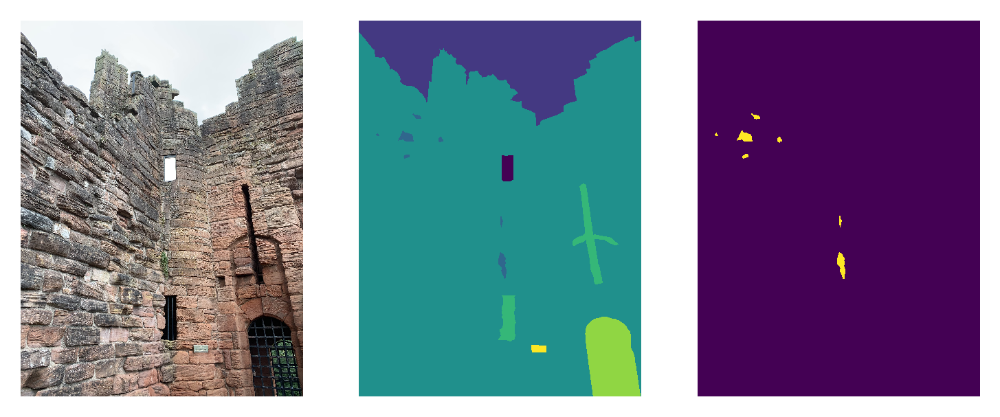

In [14]:
img1,label1,overalllabel = load_image(imgname1,rotate = rotate_list[img_ind])
plt.figure(dpi = dpi)
plt.subplot(1,3,1)
plt.imshow(np.array(img1));plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(overalllabel.squeeze().numpy());plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(np.array(label1).sum(axis = 2));plt.axis('off')
plt.axis('off')

## test the first model

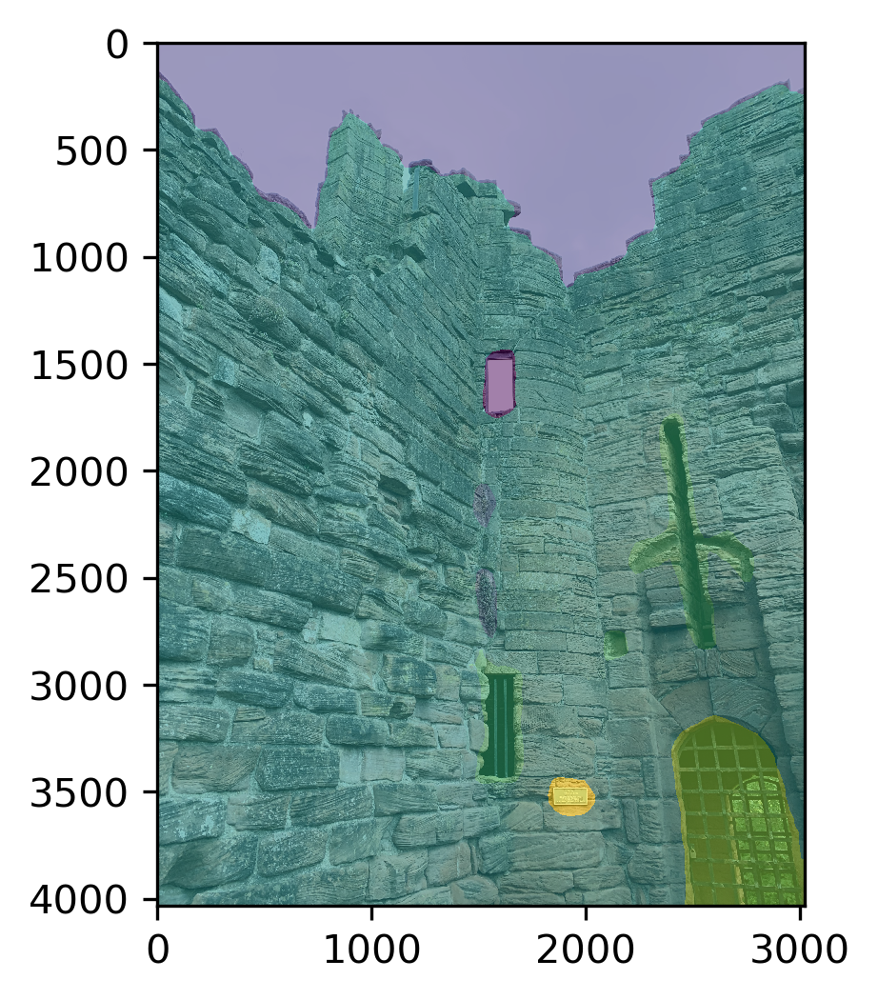

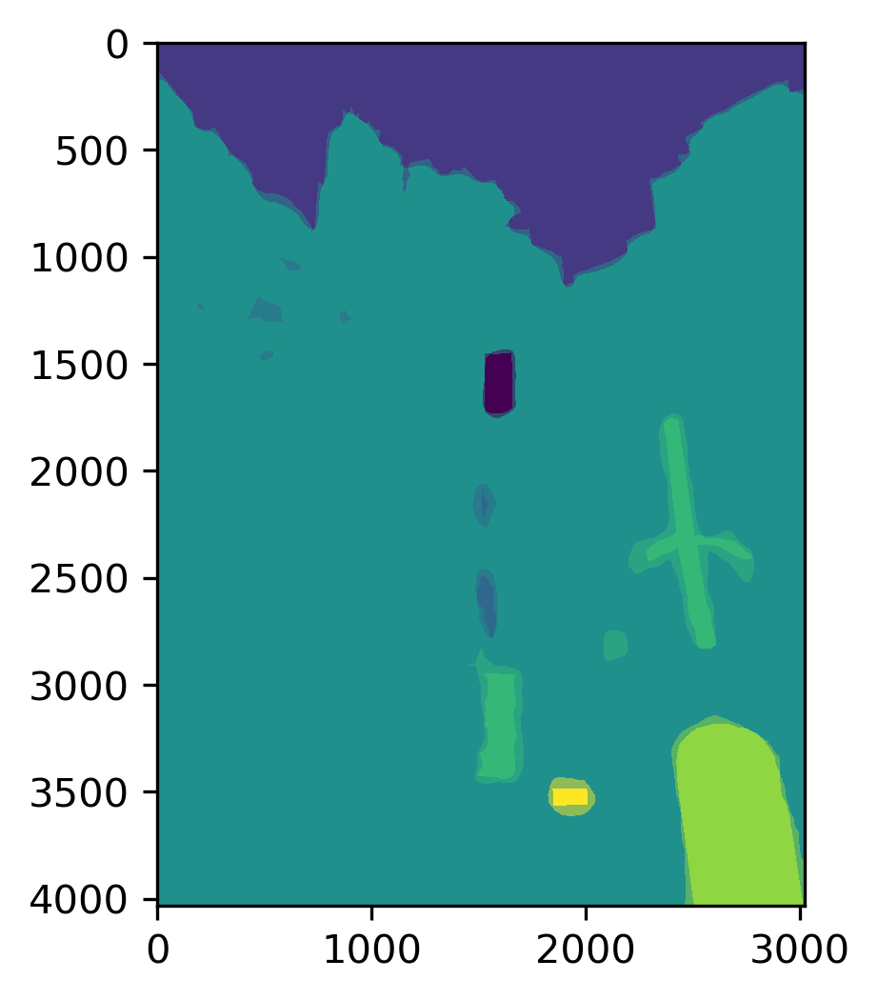

In [15]:
validation = transform1_1(img1).unsqueeze(0).to(device)
res= model1_1_(validation,interpolate = True)
res_test_1 = F.interpolate(res, size=(img1.size[1],
                                          img1.size[0]), mode='bilinear', align_corners=False)

plt.figure(dpi = dpi)
plt.imshow(np.array(img1))
plt.imshow(torch.argmax(res_test_1.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

plt.figure(dpi = dpi)
plt.imshow(overalllabel.squeeze().numpy())
plt.imshow(torch.argmax(res_test_1.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

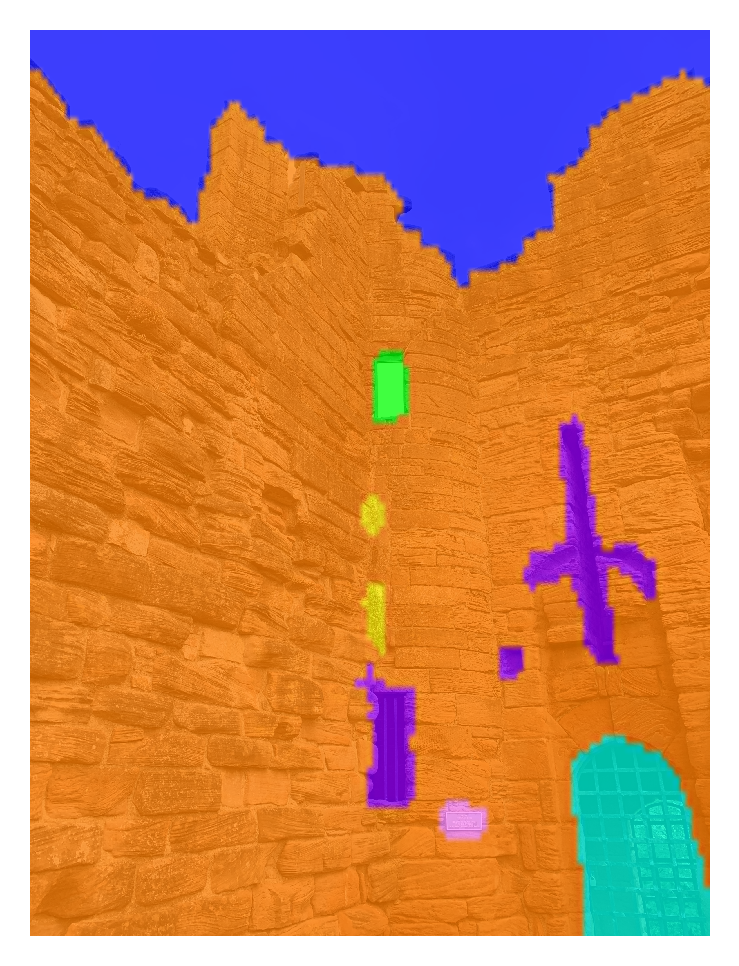

In [16]:
draw_bounding_box(img1,model1_1_,transform1_1,colors,labelnames,dpi,None,None,0.75)

In [17]:
IoU(overalllabel.squeeze(),torch.argmax(res_test_1.squeeze(),axis = 0),8)

1 0.787706291459132
2 0.9628572769973556
3 0.277816999688049
4 0.9670634772663538
5 0.5511588275391957
6 0.9152230477300574
7 0.39417981122017


0.6937151045571875

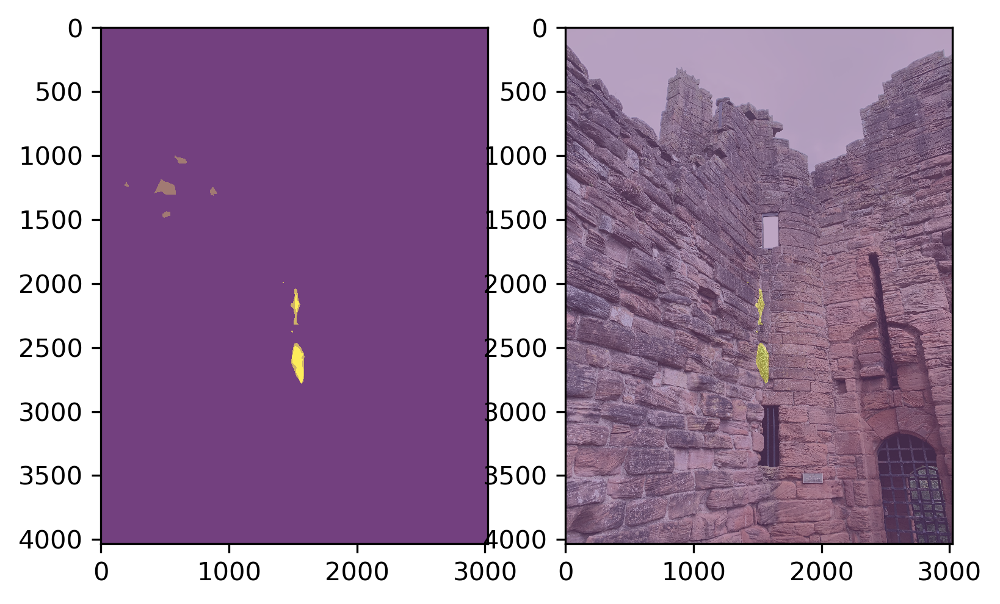

In [18]:
predicted_image1 = predict(img1,transform1_1,transform1_2,model1_1_,model_detail,3,img1.size,scale = 0.05)
plt.figure(dpi = dpi)
plt.subplot(1,2,1)
plt.imshow(np.array(label1).sum(axis = 2),alpha = 0.5)
plt.imshow(predicted_image1,alpha = 0.5)
plt.subplot(1,2,2)
plt.imshow(img1,alpha = 0.75)
plt.imshow(predicted_image1,alpha = 0.35)

plt.figure(dpi = dpi)
plt.imshow(img1,alpha = 0.75)
plt.imshow(predicted_image1,alpha = 0.35)
plt.axis('off')

## test the second model

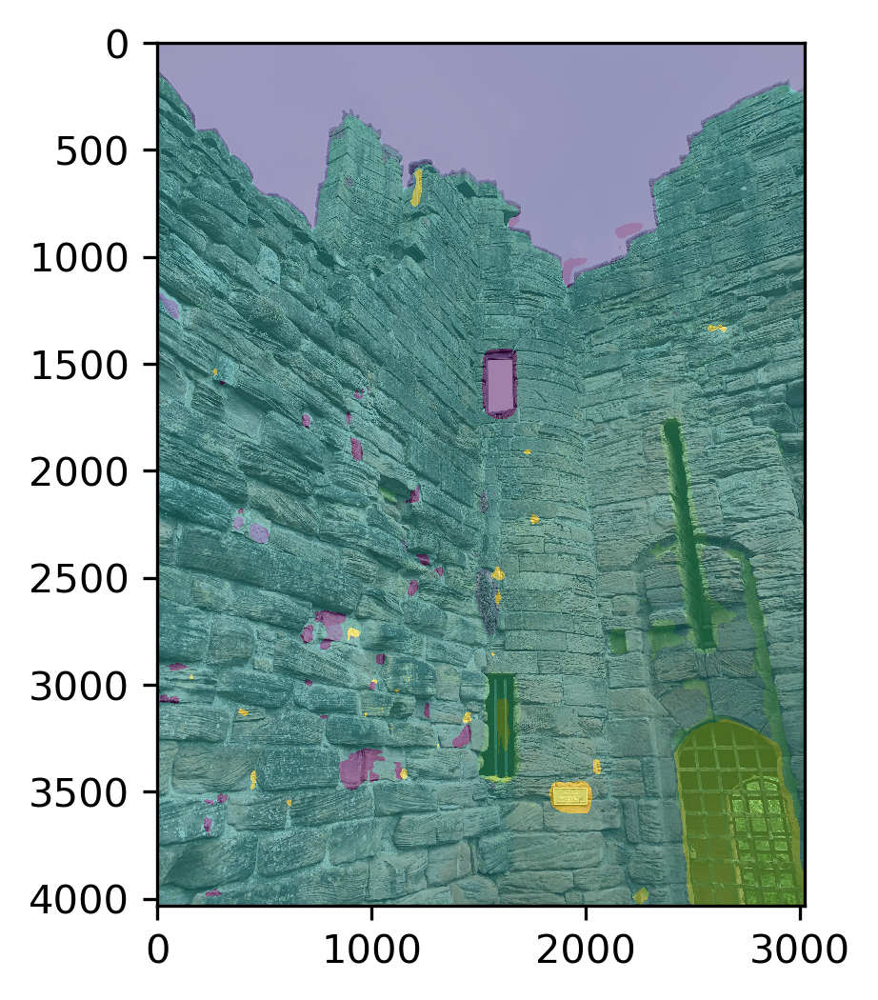

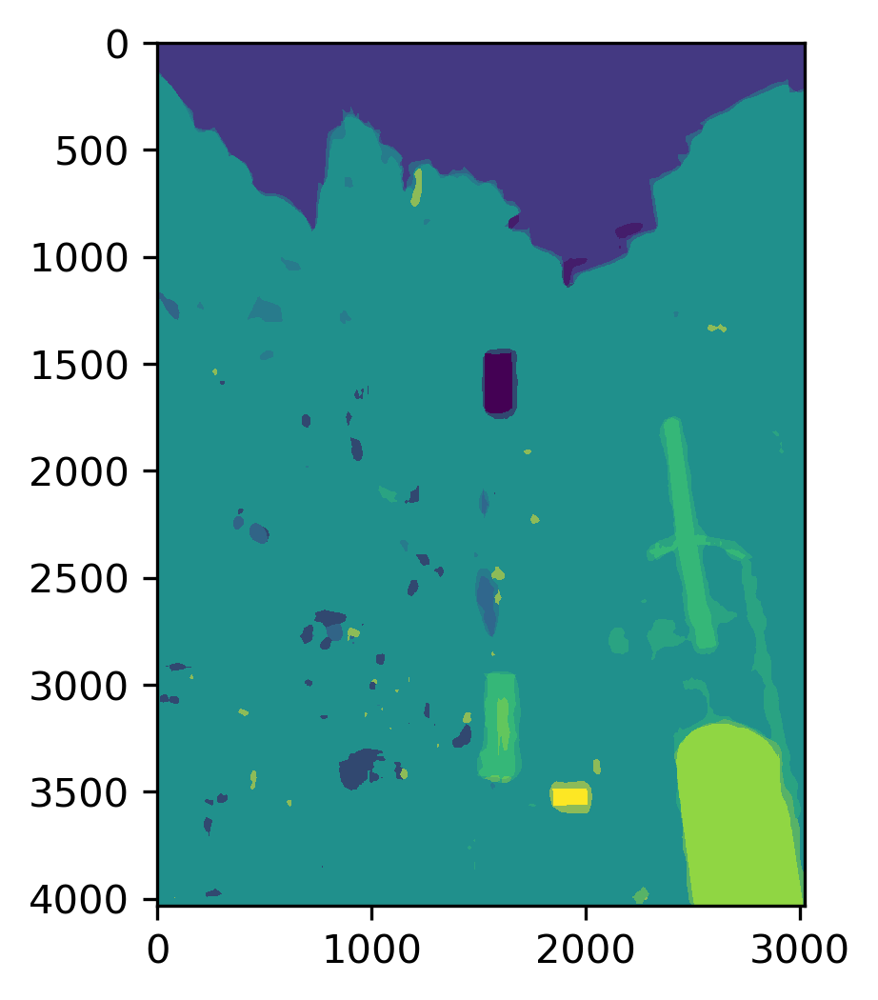

In [19]:
validation = transform2_1(img1).unsqueeze(0).to(device)
res= model2_1(validation,interpolate = True)
res_test_2 = F.interpolate(res, size=(img1.size[1],
                                          img1.size[0]), mode='bilinear', align_corners=False)

plt.figure(dpi = dpi)
plt.imshow(np.array(img1))
plt.imshow(torch.argmax(res_test_2.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

plt.figure(dpi = dpi)
plt.imshow(overalllabel.squeeze().numpy())
plt.imshow(torch.argmax(res_test_2.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

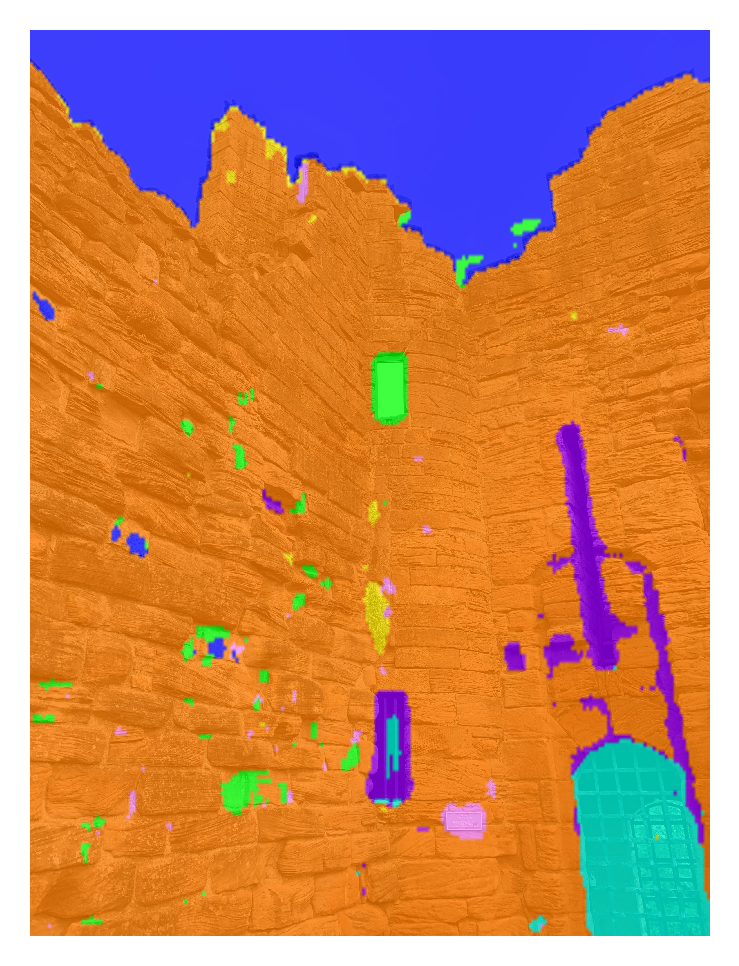

In [20]:
draw_bounding_box(img1,model2_1,transform2_1,colors,labelnames,dpi,None,None,0.75)

In [21]:
IoU(overalllabel.squeeze(),torch.argmax(res_test_2.squeeze(),axis = 0),8)

1 0.23294193168748495
2 0.951357107734604
3 0.22769344181728826
4 0.9487126796117377
5 0.41943542823848223
6 0.8949298654452272
7 0.23941489057768128


0.5592121921589294

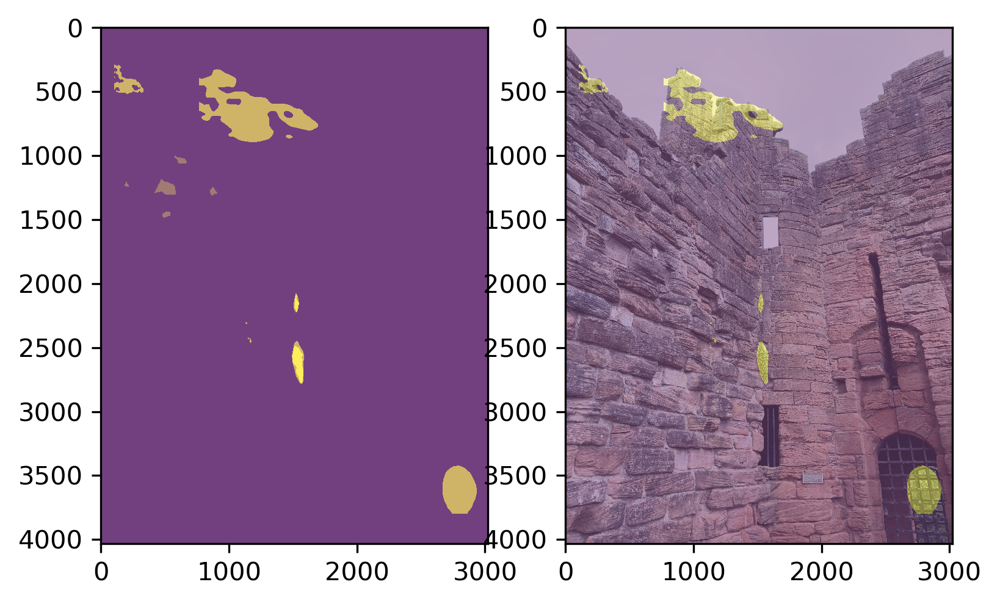

In [22]:
predicted_image2 = predict(img1,transform2_1,transform2_2,model2_1,model_detail,3,img1.size,scale = 0.05)
plt.figure(dpi = dpi)
plt.subplot(1,2,1)
plt.imshow(np.array(label1).sum(axis = 2),alpha = 0.5)
plt.imshow(predicted_image2,alpha = 0.5)
plt.subplot(1,2,2)
plt.imshow(img1,alpha = 0.75)
plt.imshow(predicted_image2,alpha = 0.35)

## test the third model

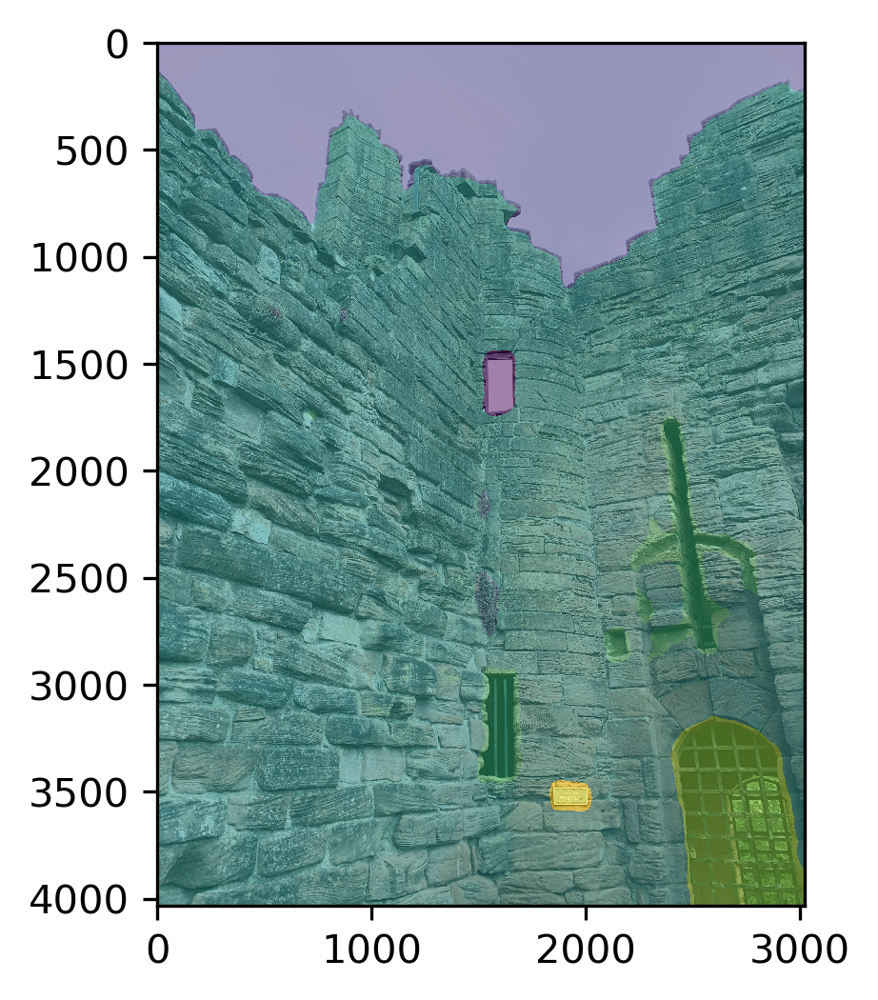

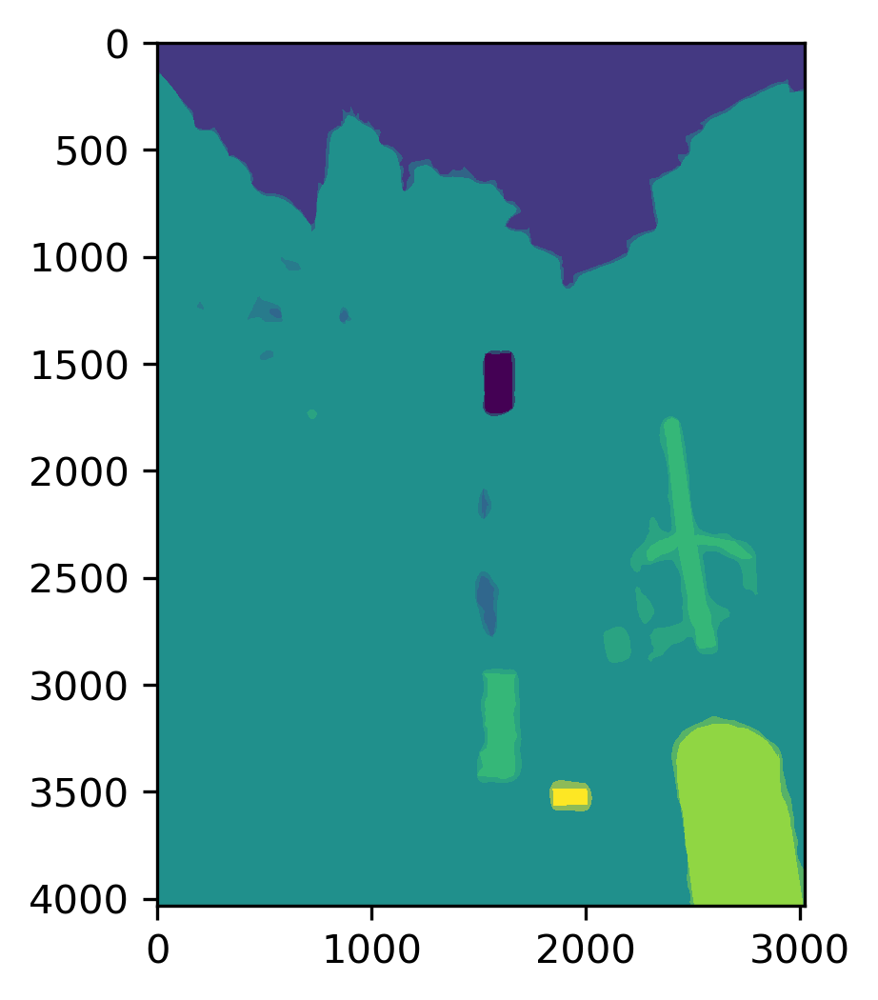

In [23]:
validation = transform3_1(img1).unsqueeze(0).to(device)
res= model3_1(validation,interpolate = True)
res_test_3 = F.interpolate(res, size=(img1.size[1],
                                          img1.size[0]), mode='bilinear', align_corners=False)

plt.figure(dpi = dpi)
plt.imshow(np.array(img1))
plt.imshow(torch.argmax(res_test_3.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

plt.figure(dpi = dpi)
plt.imshow(overalllabel.squeeze().numpy())
plt.imshow(torch.argmax(res_test_3.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

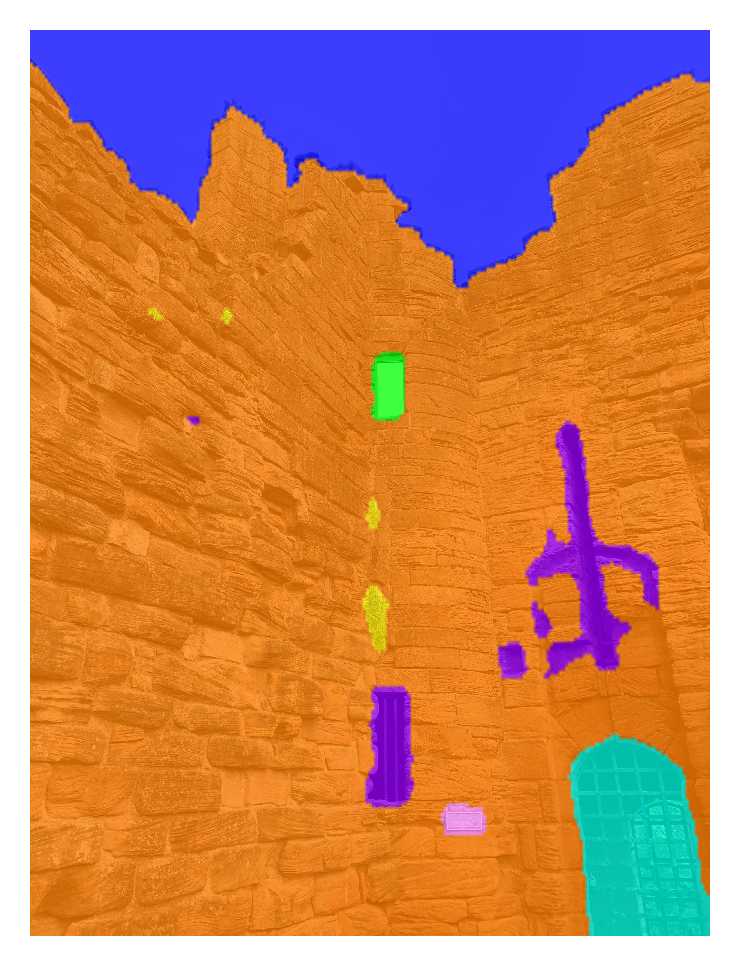

In [24]:
draw_bounding_box(img1,model3_1,transform3_1,colors,labelnames,dpi,None,None,0.75)

In [25]:
IoU(overalllabel.squeeze(),torch.argmax(res_test_3.squeeze(),axis = 0),8)

1 0.8200108498242801
2 0.9660452241851838
3 0.3955384374755611
4 0.9689314000896571
5 0.5318999047764037
6 0.9220416875595159
7 0.5016962682099382


0.7294519674457914

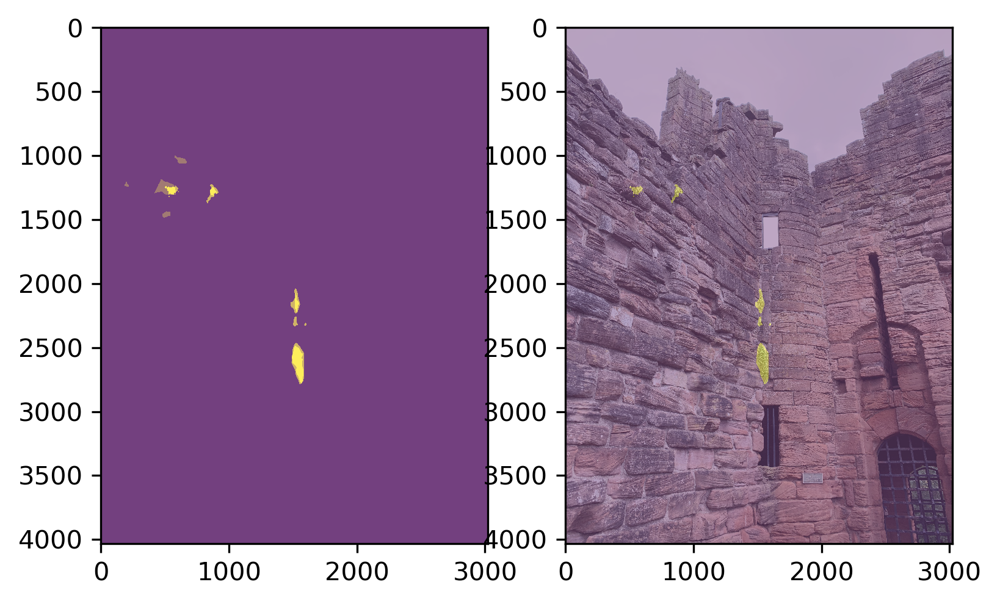

In [26]:
predicted_image3 = predict(img1,transform3_1,transform3_2,model3_1,model_detail,3,img1.size,scale = 0.05)
plt.figure(dpi = dpi)
plt.subplot(1,2,1)
plt.imshow(np.array(label1).sum(axis = 2),alpha = 0.5)
plt.imshow(predicted_image3,alpha = 0.5)
plt.subplot(1,2,2)
plt.imshow(img1,alpha = 0.75)
plt.imshow(predicted_image3,alpha = 0.35)

In [27]:
IoU(torch.tensor(predicted_image3),transforms.ToTensor()(label1).sum(axis = 0)/4,2)

0 0.9972696792066177
1 0.41429276547736565


0.7057812223419917

In [28]:
def decode_color(image,colors): # decode the segmented results using specified colors
    
    if isinstance(image,torch.Tensor):
        image = image.detach().cpu().numpy()
    if len(image.shape) <= 1:
        
        image = image.reshape(-1,1)
    
    img = np.zeros((image.shape[0],image.shape[1],3))
            
    for i in range(len(colors)):
        
        H,W = np.where(image==i)

        img[H,W,:] = colors[i]
                    
    return np.uint8(img)

red = (255,0,0)
green = (0,255,0)
blue = (0,0,255)
yellow = (255,225,0)
orange = (255,125,0)
purple = (155,0,255)
greenblue = (0,255,225)
pink = (255,140,248)
white = (255,255,255)
black = (0,0,0)
colors = [red,green,blue,yellow,orange,purple,greenblue,pink]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 899.5, 899.5, -0.5)

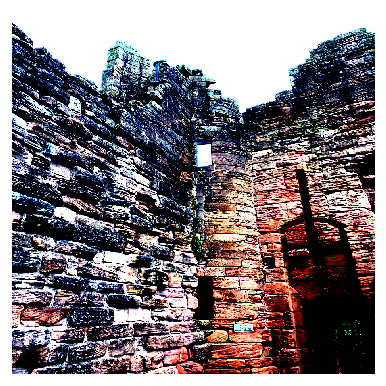

In [29]:
plt.figure(dpi = 120)
plt.imshow(transform3_1(img1).permute(1,2,0).detach().cpu().numpy());plt.axis('off')

In [30]:
res= model3_1(validation,interpolate = False)
torch.argmax(res.squeeze(),axis = 0).size()

torch.Size([225, 225])

(-0.5, 224.5, 224.5, -0.5)

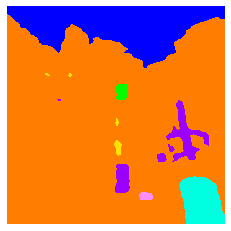

In [31]:
plt.imshow(decode_color(torch.argmax(res.squeeze(),axis = 0),colors));plt.axis('off')

In [32]:
res_2= model3_1(validation,interpolate = True)
torch.argmax(res_2.squeeze(),axis = 0).size()

torch.Size([900, 900])

(-0.5, 899.5, 899.5, -0.5)

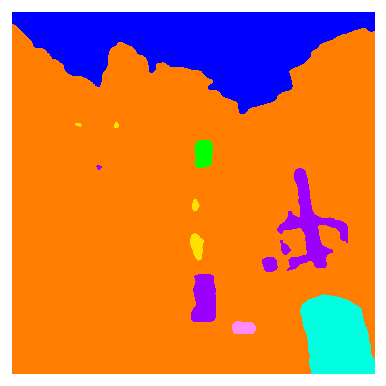

In [33]:
plt.figure(dpi = 120)
plt.imshow(decode_color(torch.argmax(res_2.squeeze(),axis = 0),colors));plt.axis('off')

In [125]:
image_size3_1 = (900,900)
image_size3_2 = (200,200)
number_of_class_firstmodel = 8
number_of_class_secondmodel = 2

transform3_1 = transforms.Compose([transforms.Resize(image_size3_1),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

transform3_2 = transforms.Compose([transforms.Resize(image_size3_2),
                                transforms.ToTensor(),
                                transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])])

model3_1 = deeplab.DeepLab(num_classes=number_of_class_firstmodel,backbone = 'resnet',output_stride = 8).to(device)

model3_1.load_state_dict(torch.load(r'E:\UCL\Dissertation\label\trained_models\model_comp\model_deeplabv3+_resnet101_last.pt'))

_ = model3_1.eval()

for p in model3_1.parameters():
    p.requires_grad = False

In [126]:
exa = Image.open(r'E:\UCL\Dissertation\otherimages\53902323-vintage-old-red-brick-wall-with-vegetation-green-grass-copy-space.jpg')

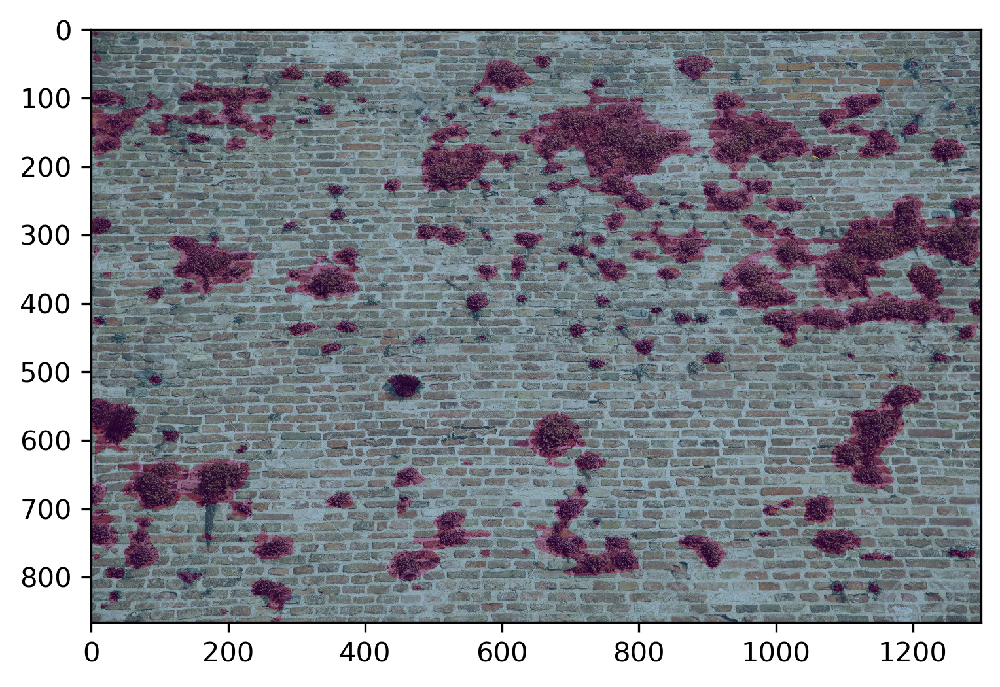

In [127]:
validation = transform3_1(exa).unsqueeze(0).to(device)
res= model3_1(validation,interpolate = True)
res_test_3 = F.interpolate(res, size=(exa.size[1],
                                          exa.size[0]), mode='bilinear', align_corners=False)

plt.figure(dpi = dpi)
plt.imshow(np.array(exa))
plt.imshow(torch.argmax(res_test_3.squeeze(),axis = 0).detach().cpu().numpy(),alpha = 0.5)

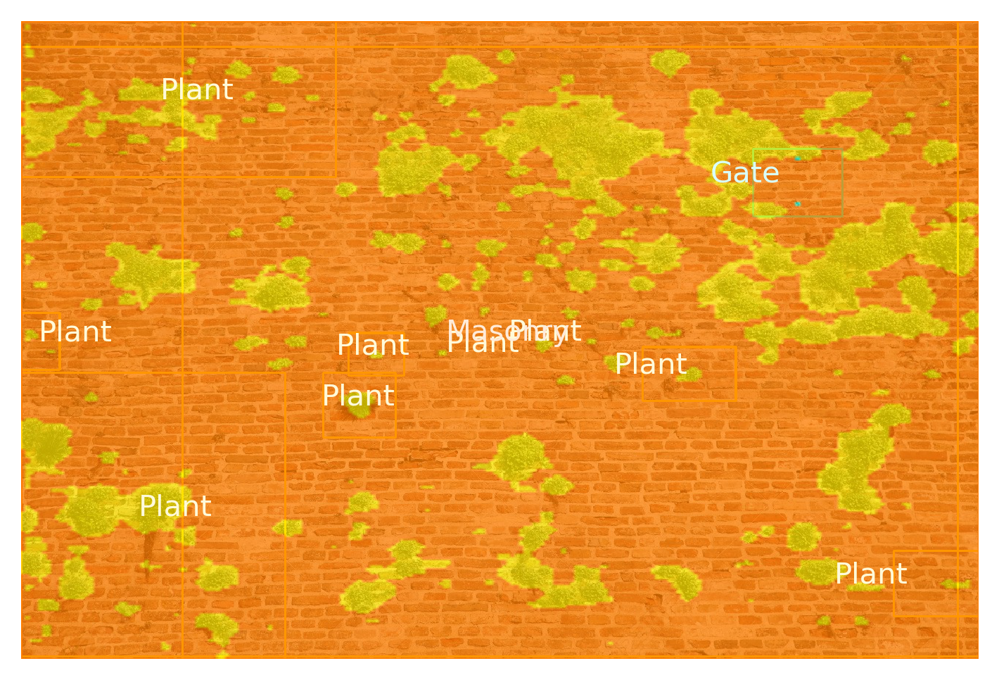

In [128]:
draw_bounding_box(exa,model3_1,transform3_1,colors,labelnames,dpi,10,2,0.75)

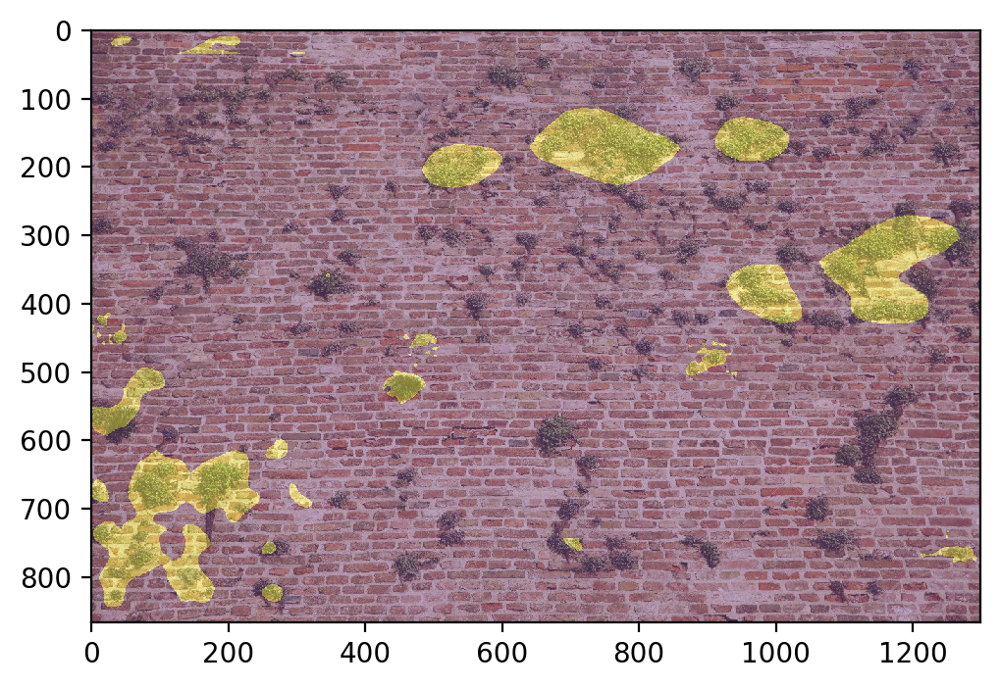

In [129]:
predicted_image3 = predict(exa,transform3_1,transform3_2,model3_1,model_detail,3,exa.size,scale = 0.05)
plt.figure(dpi = 200)
plt.imshow(exa,alpha = 0.75)
plt.imshow(predicted_image3,alpha = 0.35)